In [3]:
!pip install PyPortfolioOpt

  Using cached pyportfolioopt-1.5.5-py3-none-any.whl (61 kB)
  Using cached cvxpy-1.4.1-cp310-cp310-macosx_10_9_universal2.whl.metadata (8.8 kB)
  Using cached numpy-1.26.1-cp310-cp310-macosx_11_0_arm64.whl.metadata (61 kB)
  Using cached osqp-0.6.3.tar.gz (228 kB)
  Installing build dependencies ... error
  error: subprocess-exited-with-error
  
  × pip subprocess to install build dependencies did not run successfully.
  │ exit code: 1
  ╰─> [115 lines of output]
        Using cached oldest_supported_numpy-2023.10.25-py3-none-any.whl.metadata (9.8 kB)
        Using cached setuptools-68.2.2-py3-none-any.whl.metadata (6.3 kB)
        Using cached wheel-0.41.2-py3-none-any.whl.metadata (2.2 kB)
        Using cached setuptools_scm-8.0.4-py3-none-any.whl.metadata (6.4 kB)
        Using cached qdldl-0.1.7.post0.tar.gz (70 kB)
        Installing build dependencies: started
        Installing build dependencies: finished with status 'done'
        Getting requirements to build wheel: started


In [1]:
import pandas as pd
import pandas_datareader as pdr
import seaborn as sns
import numpy as np
import yfinance as yf
import datetime
import requests
import os, sys
import tqdm
import pickle
import glob
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from scipy.optimize import minimize
from nsepy import *

# Collect Data

In [2]:
""" Collect all stock data from ../dat_eodhd_dow30/"""

# Set the path
path = '../dat_yfinance_dow30/'
all_files = glob.glob(os.path.join(path, "*.pkl"))

# Create an empty list to hold DataFrames
dfs = []

# Iterate through all files and append the adjusted_close column to the dfs list
for filename in all_files:
    # Read the .pkl file into a DataFrame
    df = pd.read_pickle(filename)
    
    # Extract the adjusted_close column
    adj_close = df[['Close']]
    
    # Rename the column with the filename
    adj_close.columns = [os.path.basename(filename).replace('.pkl', '')]
    
    # Append the adjusted_close DataFrame to the dfs list
    dfs.append(adj_close)

# Concatenate all DataFrames along the columns axis
final_df = pd.concat(dfs, axis=1)

# EDA

<Figure size 640x480 with 0 Axes>

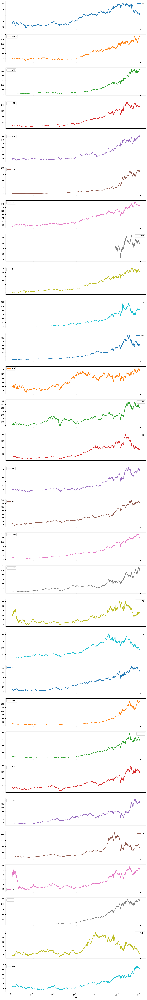

In [3]:
""" step 1: plot daily price of all the stocks """

plt.figure()
final_df.plot(subplots = True,figsize = (15,120))
# plt.title("Close prices of all stocks")
plt.show()

In [4]:
""" step 2: finding dailt returns"""

daily_returns = final_df/final_df.shift(1)
daily_returns

,VZ,AMGN,UNH,HON,WMT,AAPL,TRV,DOW,JNJ,CRM,...,KO,MSFT,HD,AXP,CVX,BA,CSCO,V,WBA,MRK
Date,,,,,,,,,,,,,,,,,,,,,
2000-01-03 00:00:00-05:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2000-01-04 00:00:00-05:00,0.967674,0.923535,0.987209,0.982359,0.962582,0.915690,0.986742,NaN,0.963390,NaN,...,1.001108,0.966220,0.947267,0.962242,1.000000,0.998445,0.943898,NaN,0.962801,0.964880
2000-01-05 00:00:00-05:00,1.033405,1.034409,0.997644,0.986532,0.979592,1.014633,0.992323,NaN,1.010556,NaN,...,1.008859,1.010544,1.020243,0.974601,1.017937,1.062305,0.996936,NaN,1.011364,1.039273
2000-01-06 00:00:00-05:00,0.994920,1.016632,1.036600,1.019341,1.010913,0.913462,1.019342,NaN,1.031337,NaN,...,1.001098,0.966502,0.952381,1.020374,1.042584,1.010264,0.983405,NaN,0.970786,1.008294
2000-01-07 00:00:00-05:00,0.992616,1.112474,1.117312,1.053571,1.075565,1.047369,1.039848,NaN,1.042539,NaN,...,1.065789,1.013069,1.058333,1.014559,1.017605,1.029027,1.058750,NaN,1.025463,1.095978
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-10-18 00:00:00-04:00,0.985401,0.997047,0.998901,0.984704,1.000743,0.992605,0.992619,0.987187,0.978474,0.976125,...,0.999630,0.994128,0.980739,0.981475,1.007936,1.000485,0.996848,0.984536,0.929978,0.979073
2023-10-19 00:00:00-04:00,1.017069,0.989492,0.991736,0.993459,0.995233,0.997839,0.975195,0.987420,0.997316,1.017039,...,1.005550,1.003666,0.988044,0.987395,1.001066,0.984383,0.991631,0.984588,0.986353,0.984704
2023-10-20 00:00:00-04:00,0.999683,0.993621,0.991347,0.994788,0.987498,0.985296,0.985665,0.990698,1.004464,0.977967,...,1.004048,0.985965,0.998745,0.946197,0.986576,0.984955,0.992686,0.998161,1.014313,1.022304


In [5]:
""" step 3: In finance, we generally use logarithmic returns for analysis"""

log_returns = np.log(final_df/final_df.shift(1))
log_returns

,VZ,AMGN,UNH,HON,WMT,AAPL,TRV,DOW,JNJ,CRM,...,KO,MSFT,HD,AXP,CVX,BA,CSCO,V,WBA,MRK
Date,,,,,,,,,,,,,,,,,,,,,
2000-01-03 00:00:00-05:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2000-01-04 00:00:00-05:00,-0.032860,-0.079546,-0.012873,-0.017798,-0.038136,-0.088077,-0.013347,NaN,-0.037297,NaN,...,0.001108,-0.034364,-0.054174,-0.038490,0.000000,-0.001556,-0.057737,NaN,-0.037908,-0.035752
2000-01-05 00:00:00-05:00,0.032860,0.033830,-0.002359,-0.013560,-0.020619,0.014527,-0.007707,NaN,0.010501,NaN,...,0.008820,0.010488,0.020040,-0.025727,0.017778,0.060441,-0.003068,NaN,0.011299,0.038521
2000-01-06 00:00:00-05:00,-0.005092,0.016495,0.035946,0.019156,0.010854,-0.090514,0.019157,NaN,0.030856,NaN,...,0.001098,-0.034072,-0.048790,0.020169,0.041703,0.010212,-0.016735,NaN,-0.029649,0.008260
2000-01-07 00:00:00-05:00,-0.007412,0.106587,0.110926,0.052185,0.072846,0.046281,0.039075,NaN,0.041659,NaN,...,0.063716,0.012984,0.056695,0.014454,0.017452,0.028614,0.057089,NaN,0.025144,0.091648
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-10-18 00:00:00-04:00,-0.014706,-0.002958,-0.001100,-0.015414,0.000743,-0.007422,-0.007408,-0.012896,-0.021761,-0.024165,...,-0.000370,-0.005890,-0.019449,-0.018698,0.007905,0.000485,-0.003157,-0.015585,-0.072594,-0.021149
2023-10-19 00:00:00-04:00,0.016925,-0.010564,-0.008298,-0.006562,-0.004778,-0.002163,-0.025118,-0.012660,-0.002688,0.016895,...,0.005535,0.003659,-0.012028,-0.012685,0.001065,-0.015741,-0.008404,-0.015532,-0.013741,-0.015414
2023-10-20 00:00:00-04:00,-0.000317,-0.006400,-0.008690,-0.005226,-0.012581,-0.014813,-0.014438,-0.009346,0.004454,-0.022280,...,0.004040,-0.014134,-0.001256,-0.055304,-0.013515,-0.015159,-0.007341,-0.001841,0.014212,0.022059


In [6]:
log_returns.mean() # for daily return
log_returns.mean() * 252 # stock market is open for 252 days in a year

VZ      0.027676
AMGN    0.075438
UNH     0.192258
HON     0.073464
WMT     0.055426
AAPL    0.223827
TRV     0.091149
DOW     0.049452
JNJ     0.075585
CRM     0.199849
NKE     0.131051
IBM     0.033792
GS      0.064451
DIS     0.053546
JPM     0.074428
PG      0.069939
MCD     0.103095
CAT     0.124405
INTC    0.013452
MMM     0.054308
KO      0.056093
MSFT    0.093037
HD      0.082272
AXP     0.062036
CVX     0.092179
BA      0.082045
CSCO    0.014868
V       0.187248
WBA     0.007395
MRK     0.056227
dtype: float64

In [7]:
# Max and Min Retrun
max_return = log_returns.mean().max() * 252
min_return = log_returns.mean().min() * 252

# Find the best and worst ticker (maximum return)
best_ticker = log_returns.mean().idxmax()
worst_ticker = log_returns.mean().idxmin()

print(f"{best_ticker}: {max_return * 100:.4f}%")
print(f"{worst_ticker}: {min_return * 100:.4f}%")

AAPL: 22.3827%
WBA: 0.7395%


In [ ]:
log_returns.std() # standard deviation --> Weekly Volatility
log_returns.cov() # covariance
log_returns.corr() # correlations

,VZ,AMGN,UNH,HON,WMT,AAPL,TRV,DOW,JNJ,CRM,...,KO,MSFT,HD,AXP,CVX,BA,CSCO,V,WBA,MRK
VZ,1.000000,0.291428,0.268598,0.365426,0.343521,0.244780,0.381472,0.379110,0.374453,0.311961,...,0.385109,0.354259,0.352319,0.397519,0.350579,0.290194,0.340417,0.375543,0.280559,0.358641
AMGN,0.291428,1.000000,0.316823,0.325682,0.300997,0.289229,0.331017,0.356061,0.397404,0.292400,...,0.284191,0.378065,0.334198,0.326448,0.295288,0.286298,0.360531,0.379468,0.290495,0.376546
UNH,0.268598,0.316823,1.000000,0.374167,0.274098,0.249533,0.414577,0.367244,0.391963,0.281363,...,0.354896,0.321232,0.349855,0.402474,0.395802,0.334058,0.248018,0.402066,0.319710,0.349063
HON,0.365426,0.325682,0.374167,1.000000,0.337161,0.347032,0.483809,0.622544,0.377904,0.423587,...,0.386190,0.462977,0.471004,0.547891,0.485454,0.551793,0.449726,0.561488,0.351350,0.348340
WMT,0.343521,0.300997,0.274098,0.337161,1.000000,0.254462,0.344204,0.288007,0.349091,0.262095,...,0.346250,0.343791,0.510189,0.344414,0.256603,0.274424,0.313775,0.336049,0.374900,0.299945
AAPL,0.244780,0.289229,0.249533,0.347032,0.254462,1.000000,0.279955,0.416870,0.221234,0.421408,...,0.228033,0.466137,0.333562,0.360112,0.265167,0.289050,0.456851,0.505594,0.230790,0.201895
TRV,0.381472,0.331017,0.414577,0.483809,0.344204,0.279955,1.000000,0.566078,0.369028,0.332759,...,0.389247,0.385708,0.435551,0.558186,0.475812,0.418632,0.360134,0.492526,0.322819,0.362382
DOW,0.379110,0.356061,0.367244,0.622544,0.288007,0.416870,0.566078,1.000000,0.340790,0.346221,...,0.489441,0.399470,0.471097,0.616794,0.591775,0.535925,0.484029,0.530481,0.442976,0.304359
JNJ,0.374453,0.397404,0.391963,0.377904,0.349091,0.221234,0.369028,0.340790,1.000000,0.287607,...,0.445929,0.333067,0.323487,0.371255,0.388849,0.324249,0.273080,0.428093,0.379208,0.513362
CRM,0.311961,0.292400,0.281363,0.423587,0.262095,0.421408,0.332759,0.346221,0.287607,1.000000,...,0.296920,0.487584,0.417849,0.399754,0.338117,0.346064,0.454792,0.487053,0.271320,0.270369


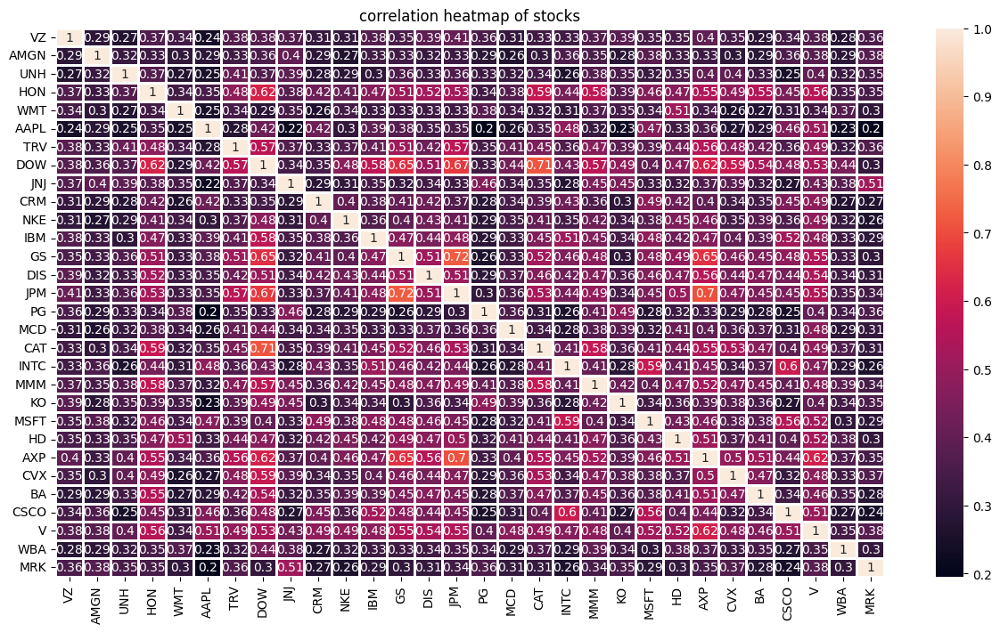

In [ ]:
# Create the heatmap with annotations
plt.figure(figsize=(15,8))
sns.heatmap(log_returns.corr(),linecolor='white',linewidths=1,annot=True)
plt.title("correlation heatmap of stocks")
plt.show()

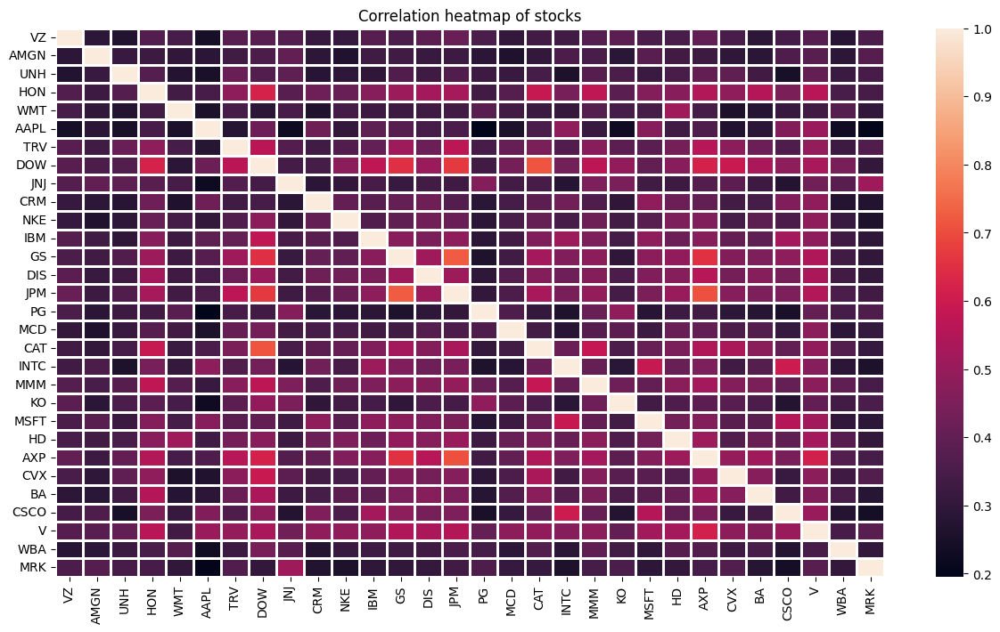

In [10]:
# Create the heatmap without annotations
plt.figure(figsize=(15,8))
sns.heatmap(log_returns.corr(), linecolor='white', linewidths=1, annot=False)
plt.title("Correlation heatmap of stocks")
plt.show()

### Using heatmap to find strongly positive or strongly negative correlated stocks

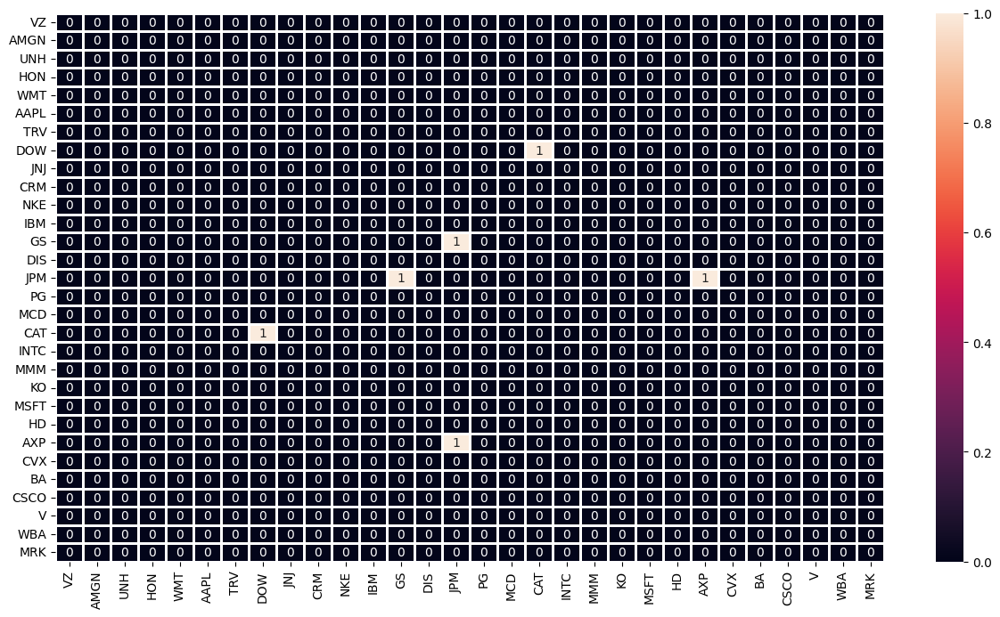

In [11]:
# Create the heatmap with annotations
plt.figure(figsize=(15,8))
c = log_returns.corr()
sns.heatmap(((c > 0.68) | (c < -0.68)) & (c != 1),linecolor='white',linewidths=1,annot = True)
plt.show()

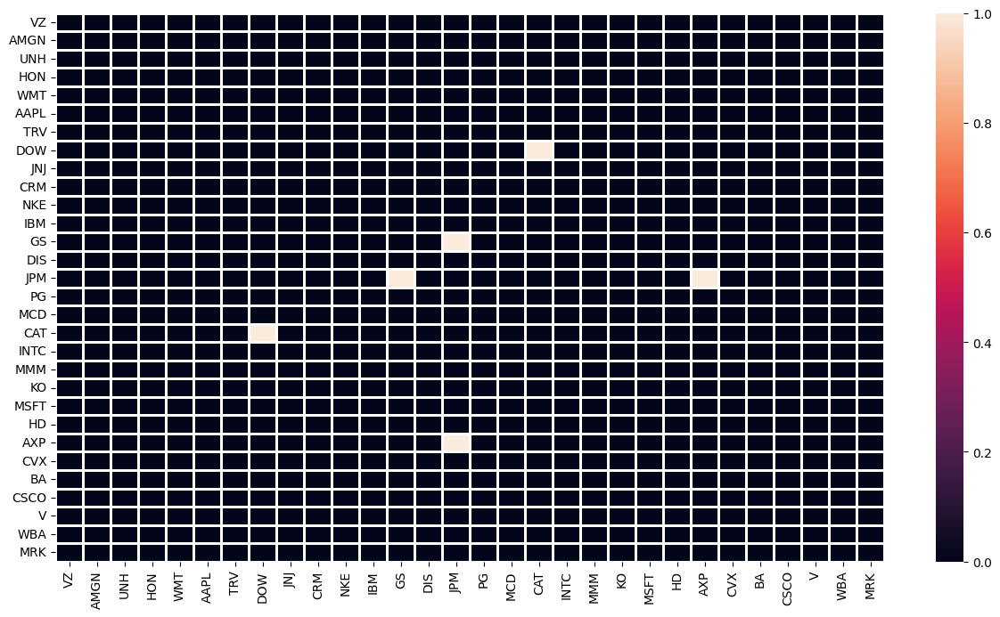

In [12]:
# Create the heatmap without annotations
plt.figure(figsize=(15,8))
c = log_returns.corr()
sns.heatmap(((c > 0.68) | (c < -0.68)) & (c != 1), linecolor='white', linewidths=1, annot=False)
plt.show()

- From the heatmaps, we can observe that there is no pair with negative correlation
- We only have some pairs of stocks from banking sector with  high positive correlation

In [13]:
sns.pairplot(final_df,palette='coolwarm')
plt.show()

/Users/rotehut/Desktop/vs_proj/port_mgmt/lib/python3.10/site-packages/seaborn/axisgrid.py:1513: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  func(x=vector, **plot_kwargs)
/Users/rotehut/Desktop/vs_proj/port_mgmt/lib/python3.10/site-packages/seaborn/axisgrid.py:1513: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  func(x=vector, **plot_kwargs)
/Users/rotehut/Desktop/vs_proj/port_mgmt/lib/python3.10/site-packages/seaborn/axisgrid.py:1513: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  func(x=vector, **plot_kwargs)
/Users/rotehut/Desktop/vs_proj/port_mgmt/lib/python3.10/site-packages/seaborn/axisgrid.py:1513: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  func(x=vector, **plot_kwargs)
/Users/rotehut/Desktop/vs_proj/port_mgmt/lib/python3.10/site-packages/seaborn/axisgrid.py:1513: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  func(

- The pair plots also signify the same result that there is no pair of stocks with high negative correlation. We don't find any pair-plot with upper-left to lower-right pattern.
- The pairs with high positive correlation have scatter plot with lower-left to upper-right pattern .
- Other pairs don't form any pattern.

# Markowitz Model
- We model our assets by their expected return, $E[R]$ and their risk, which is expressed as their standard deviation, $\sigma$
- Our investment decisions are expressed by investing 100% of our wealth in assets( here, stocks), where each particular investment represents a proportion of our total wealth. 
- We will now implement Markowitz Model. This model assists in the selection of the most efficient portfolios by analyzing various possible portfolios of the selected stocks.
- We invest $w_i$ in $stock_i$ for every i, such that

 $$\Sigma^{n}_{i=1} w_i = 1$$
 - The expected return of the portfolio constructed would be

$$E[R_p] = \Sigma^{n}_{i=1} w_i E[R_i]$$
- the risk associated with the portfolio would be

$$\sigma^2(R_p) = \Sigma^{n}_{i=1} w_i^2 \sigma^2(R_i) + \Sigma^{}_{i=1}\Sigma^{}_{j {\neq} i} w_i w_j \sigma(R_i) \sigma(R_j) \rho_{ij}$$

- $E[R_i]$ is the annual expected return of $i$th stock, $\sigma(R_i)$ corrsponds to annual standard deviation of $i$th stock and $\rho_{ij}$ is the correlation between the logarithmic returns $i$th and the $j$th stock.
- An efficient portfolio is one that maximizes return for a given level of risk. Our task is to select adequate weights $w_i$ to get the efficient portfolio

## Implementation
-  Let $W_{1 \times n}$ be a array containing the weights $w_i$ such that $\Sigma^{n}_{i=1} w_i = 1$ and $E[R]_{ n\times 1}$ be another array containing annual expected returns of n stocks present in the portfolio and $C$ be the covariance matrix of annual returns of  stocks, then

$$E[R_p] = WE[R]$$

$$ \sigma^2(R_p) = W^TCW $$

### Sharpe Ratio

- It is a statistical measure used in Modern Portfolio Theory.
- The Sharpe ratio measures the performance of an investment compared to a risk-free asset, after adjusting for its risk. It is defined as the difference between the returns of the investment and the risk-free return, divided by the standard deviation of the investment.
- A portfolio with a higher Sharpe ratio is considered to have best risk-adjusted returns.

$$ S = \frac{E[R_p] - R_f}{\sigma(R_p)} $$

Here, $R_f$ is the risk free rate of return. I have taken risk free rate as 10 year government bond rate of India on July 9th, i.e 6.19%

In [14]:
# A function for generating a numpy array containing random weights that add upto 1
def RandWeights(size):
    weight = np.random.dirichlet(np.ones(size))
    return weight

In [15]:
risk_free_rate = 0.0619 # 6.19% on July 9

# A function to generate the avg return, risk and the sharpe ratio of the portfolio 
# correponding to the weight array passed
def portfolio_stats(weight):

    # Convert to array in case list was passed instead.
    weight = np.array(weight)
    port_return = np.sum(log_returns.mean() * weight) * 250
    port_risk = np.sqrt(np.dot(weight.T, np.dot(log_returns.cov() * 250, weight)))
    sharpe = (port_return - risk_free_rate)/port_risk

    return {'return': port_return, 'risk': port_risk, 'sharpe': sharpe}

In [16]:
# Trying to generate random weights

length = len(log_returns.columns)
weight = RandWeights(length)
weight

array([0.07867774, 0.12422305, 0.03589677, 0.00488232, 0.00397239,
       0.00529543, 0.03614651, 0.05478141, 0.06753268, 0.00714363,
       0.02296179, 0.02474583, 0.01094033, 0.01386132, 0.00932102,
       0.00670299, 0.000947  , 0.01651315, 0.00699796, 0.02324594,
       0.01461334, 0.04422144, 0.0717617 , 0.13864337, 0.03098092,
       0.01066343, 0.00356838, 0.0833845 , 0.00074781, 0.04662588])

In [17]:
# Generating Portfolio Statistics
pf_stats = portfolio_stats(weight)

pf_return = pf_stats['return']
pf_risk = pf_stats['risk']
sharpe_ratio = pf_stats['sharpe']

In [18]:
print(f'Portfolio Return    : {pf_return * 100:.2f} %')
print(f'Portfolio Risk      : {pf_risk * 100:.2f} %')
print(f'Portfolio Sharpe    : {sharpe_ratio * 100:.2f} %')

Portfolio Return    : 8.35 %
Portfolio Risk      : 20.23 %
Portfolio Sharpe    : 10.68 %


#### We will now run a monte carlo simulation to generate random portfolios. We will use the results of simulation to draw an efficient frontier

In [19]:
def Monte_Carlo(iterations):
    portfolio_returns = []
    portfolio_risks = []
    for x in range (iterations):
        weight = RandWeights(length)
        pf_stats = portfolio_stats(weight)
        portfolio_returns.append(pf_stats['return'])
        portfolio_risks.append(pf_stats['risk'])
        
    portfolio_returns = np.array(portfolio_returns)
    portfolio_risks = np.array(portfolio_risks)
    return portfolio_returns, portfolio_risks

# Course: 
    

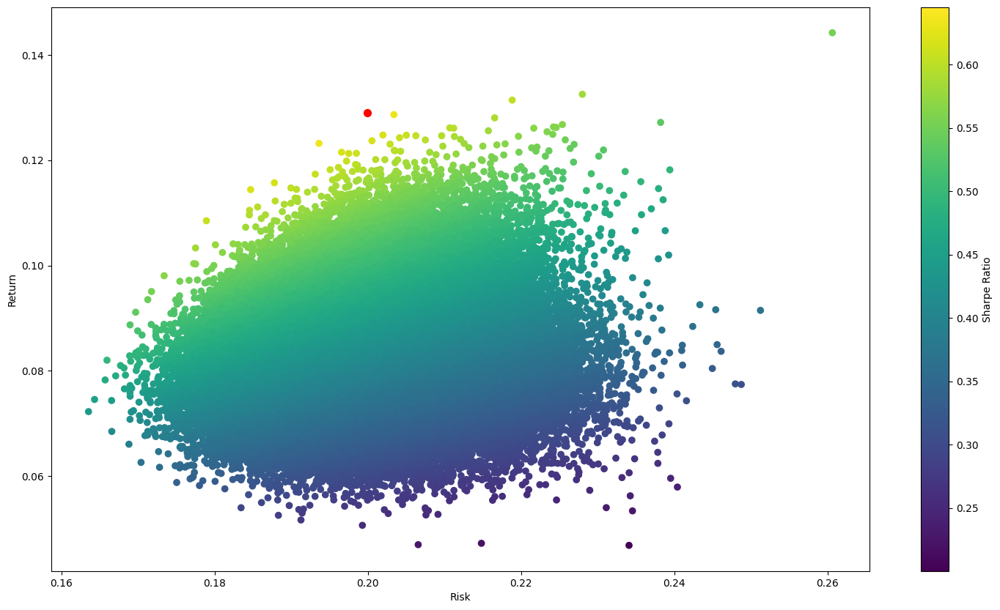

In [20]:
portfolio_returns, portfolio_risks = Monte_Carlo(100000)
sharpe = portfolio_returns / portfolio_risks
max_sr_ret = portfolio_returns[sharpe.argmax()] # return corresponding to maximum sharpe ratio
max_sr_vol = portfolio_risks[sharpe.argmax()] # risk corresponding to maximum sharpe ratio
plt.figure(figsize=(18,10))
plt.scatter(portfolio_risks, portfolio_returns, c=sharpe, cmap='viridis')
plt.colorbar(label='Sharpe Ratio')
plt.xlabel('Risk')
plt.ylabel('Return')
plt.scatter(max_sr_vol, max_sr_ret,c='red', s=50) # red dot
plt.show()

- The above plot shows comparison of all portfolio combinations generated in Mone Carlo Simulation in terms of their risk and return. The red dot corresponds to the portfolio having the highest sharpe ratio amoung the generated portfolios. ( This portfolio may not be the one with highest sharpe ratio as we are plotting random portfolios. It is just the portfolio with highest sharpe ratio amoung all the randomly generated portfolios)
- We will now try to generate optimized portffolios subject to various conditions
- This hyperbolic plot is called 'Markowitz's Bullet'

#### Using Optimization to find portfolio with max sharpe ratio
- The below function returns the weights array cooresponding to the portfolio with the highest Sharpe Ratio
- We are using Scipy.optimize.minimize. We are trying to minimize negative Sharpe Ratio (which is same as maximising the sharpe ratio)
- The constraint for optimization is -> Sum of all the weights has to be 1, and all the weights are bounded between 0 and 1

In [21]:
def OptimizationWithSharpeRatio():

    def FindNegSharpe(weight):
        return (-1)*portfolio_stats(weight)['sharpe']

    res = minimize(
          FindNegSharpe,
          RandWeights(length),
          method = 'SLSQP',
          constraints=[
            {'type': 'eq', 'fun': lambda w: np.sum(w) - 1.},
          ],
          bounds=[(0., 1.) for i in range(length)]
        )
    
    return res


In [22]:
OptimizationWithSharpeRatio()

 message: Optimization terminated successfully
 success: True
  status: 0
     fun: -0.5521379059827435
       x: [ 3.374e-17  1.159e-16 ...  8.682e-17  0.000e+00]
     nit: 7
     jac: [ 9.189e-02 -1.830e-02 ...  2.337e-01  1.570e-02]
    nfev: 217
    njev: 7

- The optimization is successful. 
- The required weights are in the key x

#### Using Optimisation to find portfolio that has minimum risk for a given expected return

- Sometimes, the investors want to have a portfolio with a fixed targert return. 
- They want to find portfolio that would provide that return with minimum risk involved

In [23]:
def OptimizationForAGivenReturn(target_return):
    
    def fun(weight):
        pf_stats = portfolio_stats(weight)
        _risk = pf_stats['risk']
        return _risk
    
    res = minimize(
      fun,
      RandWeights(length),
      method = 'SLSQP',
      constraints=[{'type':'eq','fun': lambda x: portfolio_stats(x)['return']-target_return},
                   {'type':'eq','fun': lambda x: np.sum(x)-1}],
      bounds=[(0., 1.) for i in range(length)]
    )
    
    return res


In [24]:
OptimizationForAGivenReturn(0.4)

 message: Positive directional derivative for linesearch
 success: False
  status: 8
     fun: 0.40621777954154975
       x: [ 3.233e-18  6.384e-18 ...  6.210e-13  7.891e-13]
     nit: 31
     jac: [ 5.836e-02  8.870e-02 ...  6.663e-02  5.360e-02]
    nfev: 1087
    njev: 27

- For a return of 40%, we can find the optimal portfolio corresponding to the weights generated above

#### Finding portfolio that provide the minimum risk

In [25]:
def OptimizingWithMinRisk():
    
    def fun(weight):
        pf_stats = portfolio_stats(weight)
        _risk = pf_stats['risk']
        return _risk
        
    
    res = minimize(
      fun,
      RandWeights(length),
      method = 'SLSQP',
      constraints=[
        {'type': 'eq', 'fun': lambda w: np.sum(w) - 1.},
      ],
      bounds=[(0., 1.) for i in range(length)]
    )

    return res

### Plotting the efficient Frontier

- The efficient frontier is the set of optimal portfolios that offer the highest expected return for a defined level of risk or the lowest risk for a given level of expected return. Portfolios that lie below the efficient frontier are sub-optimal because they do not provide enough return for the level of risk.

- We will plot the efficient frontier by taking the optimal portfolios for all possible returns

In [26]:
target_returns = np.linspace(portfolio_returns.min(), portfolio_returns.max(),70)

minimal_risks = []
for target_return in target_returns:
    optimal = OptimizationForAGivenReturn(target_return)
    minimal_risks.append(optimal['fun'])

minimal_risks = np.array(minimal_risks)
print(minimal_risks)

[0.15537815 0.15441616 0.15353348 0.15273129 0.15201049 0.15137298
 0.15081902 0.15035013 0.14996406 0.14966203 0.149443   0.14929884
 0.14922733 0.14921568 0.14923909 0.14928408 0.14934982 0.14943592
 0.14954479 0.14967716 0.14983283 0.15001294 0.15021668 0.15044554
 0.15069959 0.15097718 0.15127637 0.15159644 0.15193512 0.15229381
 0.15267039 0.15306667 0.15348147 0.15391782 0.15437593 0.15485602
 0.15535894 0.15588289 0.15642971 0.15699758 0.15758799 0.15819891
 0.15883091 0.15948482 0.16016006 0.16085648 0.16157356 0.16231364
 0.16307732 0.1638664  0.16467965 0.16551626 0.166377   0.16726003
 0.16816603 0.16909408 0.17004443 0.17101649 0.17200992 0.17302426
 0.17405907 0.17511397 0.17618854 0.1772825  0.17839592 0.17953032
 0.18068684 0.18186372 0.18306202 0.18428079]


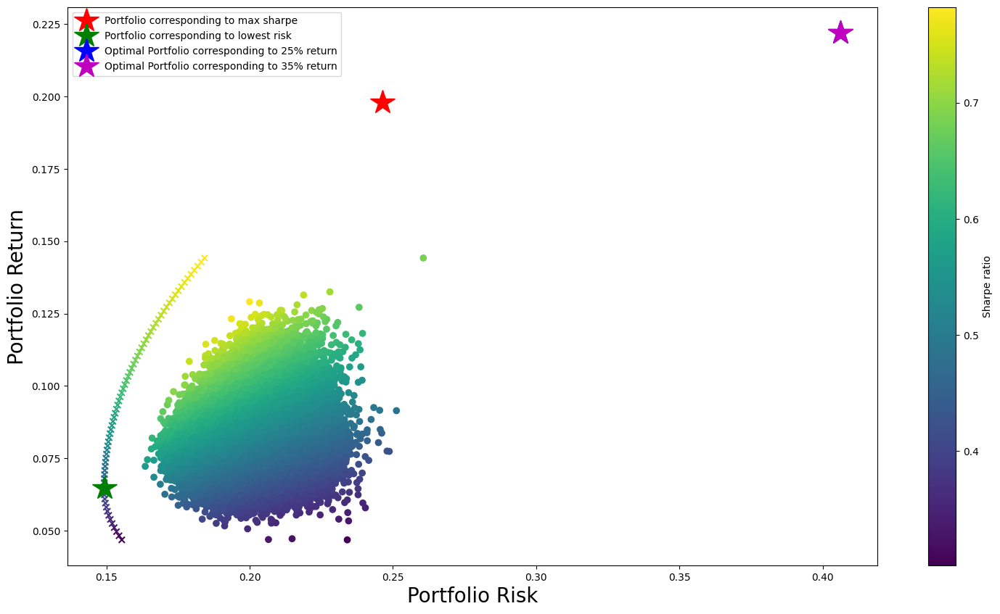

In [27]:
plt.figure(figsize=(18,10))

plt.scatter(portfolio_risks, portfolio_returns,
            c = ( portfolio_returns / portfolio_risks),
            marker = 'o')


# Plotting the efficient frontier
plt.scatter(minimal_risks,
            target_returns,
            c = (target_returns / minimal_risks),
            marker = 'x')


#Plotting the portfolio that has highest Sharpe Ratio
Optimal_weights_For_Highest_Sharpe_Ratio = OptimizationWithSharpeRatio().x

plt.plot(portfolio_stats(Optimal_weights_For_Highest_Sharpe_Ratio)['risk'],
         portfolio_stats(Optimal_weights_For_Highest_Sharpe_Ratio)['return'],
         'r*',
         markersize = 25.0, label = "Portfolio corresponding to max sharpe")


#Plotting the optimal portfolio that has lowest risk
Optimal_weights_For_Lowest_Risk = OptimizingWithMinRisk().x

plt.plot(portfolio_stats(Optimal_weights_For_Lowest_Risk)['risk'],
         portfolio_stats(Optimal_weights_For_Lowest_Risk)['return'],
         'g*',
         markersize = 25.0, label = "Portfolio corresponding to lowest risk")

#Plotting the optimal portfolio for 25% annual returns
Optimal_weights_for_twenty_five_percent_returns = OptimizationForAGivenReturn(0.25).x

plt.plot(portfolio_stats(Optimal_weights_for_twenty_five_percent_returns)['risk'],
         portfolio_stats(Optimal_weights_for_twenty_five_percent_returns)['return'],
         'b*',
         markersize = 25.0, label = "Optimal Portfolio corresponding to 25% return")

#Plotting the optimal portfolio for 35% annual returns
Optimal_weights_for_thirty_five_percent_returns = OptimizationForAGivenReturn(0.35).x

plt.plot(portfolio_stats(Optimal_weights_for_thirty_five_percent_returns)['risk'],
         portfolio_stats(Optimal_weights_for_thirty_five_percent_returns)['return'],
         'm*',
         markersize = 25.0, label = "Optimal Portfolio corresponding to 35% return")

plt.xlabel('Portfolio Risk',fontsize = 20)
plt.ylabel('Portfolio Return', fontsize = 20)
plt.legend(prop={'size': 10})
plt.colorbar(label='Sharpe ratio')

- The efficient frontier is different for different investors, depending upon the assets they are holding
- There is nothing like a single optimal portfolio. The efficient frontier is the collection of optimal portfolios.
- The investors can choose any optimal portfolio depending upon the risk they can take